In [4]:
import os 
import skimage
from PIL import Image

In [3]:
def create_image_grid(images, A, B):
    if len(images) != A * B:
        raise ValueError(f"Number of images ({len(images)}) does not match the grid size {A}x{B} ({A*B}).")

    # Get the width and height of the first image
    img_width, img_height = images[0].size

    # Create a new blank image with size (A * width, B * height)
    grid_width = A * img_width
    grid_height = B * img_height
    grid_image = Image.new('RGB', (grid_width, grid_height))

    # Paste the images into the grid
    for i, img in enumerate(images):
        x_offset = (i % A) * img_width
        y_offset = (i // A) * img_height
        grid_image.paste(img, (x_offset, y_offset))

    return grid_image

In [34]:
#LRS = ['5e-4','1e-4','5e-5','1e-5']
LR = '5e-4'
GUIDANCE_SCALES = ["1.0", "3.0", "5.0","7.0"]
#CHKPTS = [0,1,2,3,4,5,10,15,20,25,30,35]
CHKPTS = [0,1,2,3,4,5,10,15,20,25,30,35]
IMAGE_TO_SHOW = '00000.png'
SCENE = 'val_z'

In [38]:
images=  []
for guidance_scale in GUIDANCE_SCALES:
    for chkpt in CHKPTS:
        try:
            img = Image.open(f'../../output/20240811/{SCENE}/{guidance_scale}/no_consistnacy/{LR}/chk{chkpt}/lightning_logs/version_0/crop_image/'+IMAGE_TO_SHOW)
            img = img.resize((256,256))
        except:
            img = Image.new('RGB', (256,256))
        images.append(img)

In [39]:
output = create_image_grid(images, len(CHKPTS), len(GUIDANCE_SCALES))

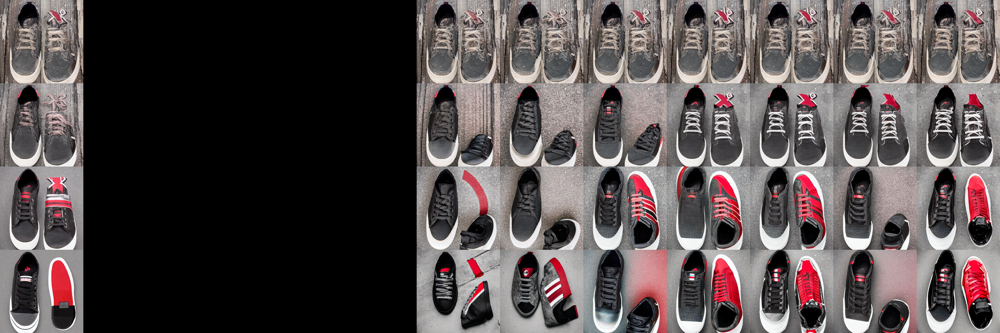

In [40]:
display(output)

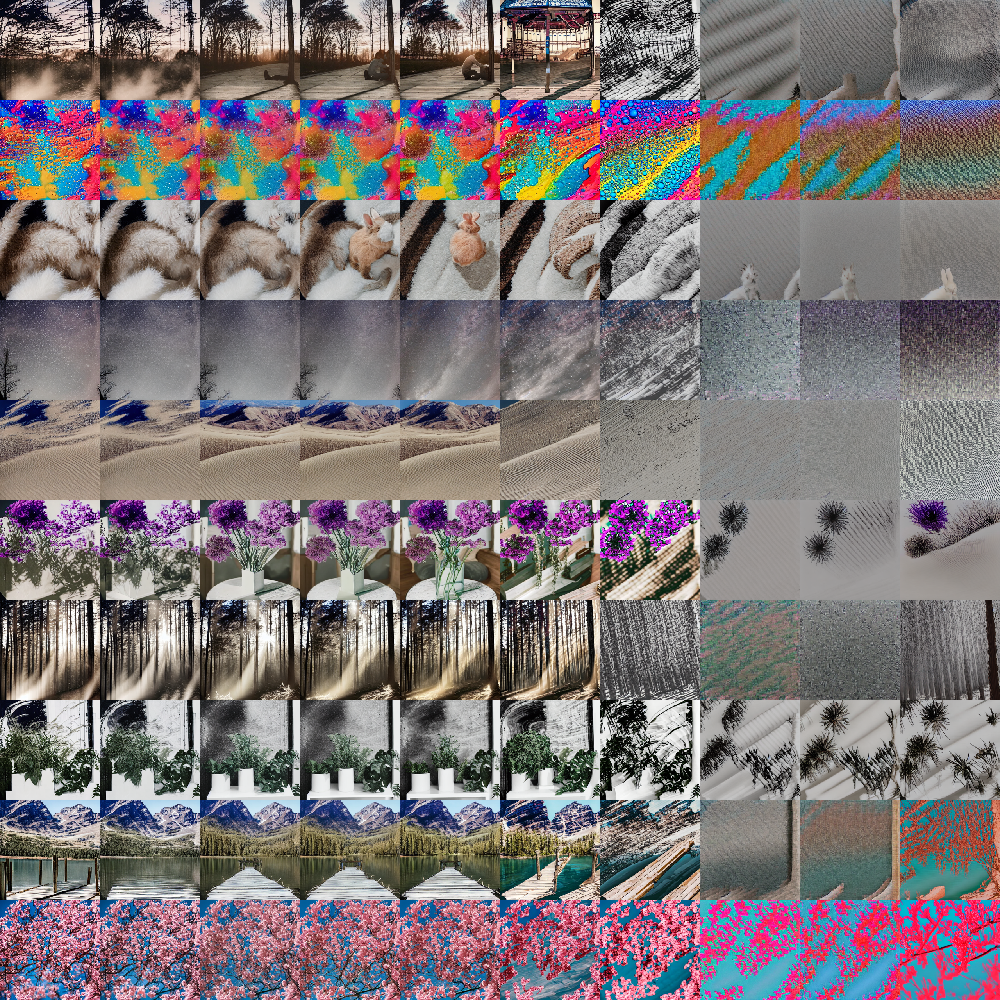

In [50]:
# RAINBOW 
#LRS = ['5e-4','1e-4','5e-5','1e-5']
LR = '1e-4'
GUIDANCE_SCALE = '3.0'
CHECKPOINT = 30
IMAGE_TO_SHOW = range(100)
SCENE = 'val_rainbow'
images=  []
for idx in IMAGE_TO_SHOW:
    try:
        path = f'../../output/20240811/{SCENE}/{GUIDANCE_SCALE}/no_consistnacy/{LR}/chk{CHECKPOINT}/lightning_logs/version_0/crop_image/{idx:05d}.png'
        img = Image.open(path)
        img = img.resize((256,256))
    except:
        img = Image.new('RGB', (256,256))
    images.append(img)
output = create_image_grid(images, 10, 10)
display(output)